# Section 1: Prediction Model

In [3]:
from random import seed
from random import randrange
from csv import reader
from math import sqrt
from sklearn import preprocessing
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
from sklearn.metrics import mean_squared_error,mean_absolute_error
from numpy import random
from sklearn.model_selection import train_test_split
import datetime as dt
from scipy import stats

In [4]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


In [5]:
df = pd.read_csv('/content/drive/MyDrive/ISDS 577 Group Project/Datasets/Combined/finished_dataset.csv', parse_dates={ 'Date': ['Year', 'Month','Day'] })
print(df.shape)

(6044400, 25)


In [6]:
df.head()

,Date,Unnamed: 0,ID,Latitude,Longitude,Hour,Minute,DHI,DNI,Wind Speed,Temperature,Clearsky DHI,Clearsky DNI,Clearsky GHI,Cloud Type,Dew Point,Fill Flag,GHI,Relative Humidity,Solar Zenith Angle,Surface Albedo,Pressure,Precipitable Water,Wind Direction,Zipcode
0,2010-01-01,0,78066,33.45,-117.66,0,30,0,0,2.5,11.0,0,0,0,7,2.0,0,0,61.77,166.91,0.091,1020,1.640,71.3,92624
1,2010-01-01,1,78066,33.45,-117.66,1,30,0,0,3.0,11.0,0,0,0,4,1.0,0,0,58.43,156.51,0.091,1020,1.659,67.5,92624
2,2010-01-01,2,78066,33.45,-117.66,2,30,0,0,3.3,11.0,0,0,0,1,0.0,0,0,55.57,144.34,0.091,1020,1.676,68.4,92624
3,2010-01-01,3,78066,33.45,-117.66,3,30,0,0,3.4,11.0,0,0,0,0,0.0,0,0,54.06,131.85,0.091,1020,1.706,69.9,92624
4,2010-01-01,4,78066,33.45,-117.66,4,30,0,0,3.4,11.0,0,0,0,3,0.0,0,0,53.25,119.41,0.091,1020,1.756,71.8,92624


In [7]:
#select columns required
df2 = df[["Zipcode", 'Date', "GHI"]]
df2.head(10)
df3 = df2.groupby(['Zipcode','Date']).sum()
print(df3)

                     GHI
Zipcode Date            
90620   2010-01-01  2644
        2010-01-02  3570
        2010-01-03  2801
        2010-01-04  2530
        2010-01-05  3513
...                  ...
92887   2019-12-27  3459
        2019-12-28  3510
        2019-12-29  2591
        2019-12-30  1627
        2019-12-31  3480

[251850 rows x 1 columns]


In [17]:
df4 = pd.DataFrame(df3)
df4.reset_index(inplace=True)
df4.head()

,Zipcode,Date,GHI
0,90620,2010-01-01,2644
1,90620,2010-01-02,3570
2,90620,2010-01-03,2801
3,90620,2010-01-04,2530
4,90620,2010-01-05,3513


In [18]:
#select columns required
df5 = df4.groupby(['Zipcode']).mean()
df5.head()

,GHI
Zipcode,
90620,5385.757534
90621,5423.654247
90623,5401.101096
90630,5427.660274
90720,5415.033425


In [46]:
df5 = pd.DataFrame(df5)
df5.reset_index(inplace=True)
df5.head()

,Zipcode,GHI
0,90620,5385.757534
1,90621,5423.654247
2,90623,5401.101096
3,90630,5427.660274
4,90720,5415.033425


In [19]:
temp_df = pd.read_csv('/content/drive/MyDrive/ISDS 577 Group Project/Datasets/Combined/Future_Predicted_Temperatures.csv')
temp_df.head()

,ZipCode,Year,Month,Day,Date,Predicted_Temperature,Efficiency
0,92624,2021,1,1,1/1/2021,14.668167,0.0
1,92624,2021,2,1,2/1/2021,12.274227,0.0
2,92624,2021,3,1,3/1/2021,14.668167,0.0
3,92624,2021,4,1,4/1/2021,17.101500,0.0
4,92624,2021,5,1,5/1/2021,16.701500,0.0


In [20]:
temp_df2 = temp_df[["ZipCode","Efficiency"]]
temp_df2.head()

,ZipCode,Efficiency
0,92624,0.0
1,92624,0.0
2,92624,0.0
3,92624,0.0
4,92624,0.0


In [21]:
temp_df2.dtypes

ZipCode         int64
Efficiency    float64
dtype: object

In [22]:
temp_df2['Efficiency'] = temp_df2['Efficiency'].replace([0.0],100)
temp_df2.head()

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  """Entry point for launching an IPython kernel.


,ZipCode,Efficiency
0,92624,100.0
1,92624,100.0
2,92624,100.0
3,92624,100.0
4,92624,100.0


In [23]:
temp_df3 = temp_df2.groupby(['ZipCode']).mean()
temp_df3 = pd.DataFrame(temp_df3)
temp_df3.reset_index(inplace=True)
temp_df3.head()

,ZipCode,Efficiency
0,90620,100.0
1,90621,100.0
2,90623,100.0
3,90630,100.0
4,90720,100.0


In [24]:
temperature_eff = list(temp_df3["Efficiency"])

In [27]:
df5["Temperature_efficiency"] = temperature_eff
df5.reset_index(inplace=True)
df5.head()

,Zipcode,GHI,Temperature_efficiency
0,90620,5385.757534,100.0
1,90621,5423.654247,100.0
2,90623,5401.101096,100.0
3,90630,5427.660274,100.0
4,90720,5415.033425,100.0


In [31]:
final_df = {}
for row in df5.itertuples():
    key = row.Zipcode
    val = (row.GHI, row.Temperature_efficiency)
    final_df[key] = val
    
print(final_df)

{90620: (5385.757534246575, 100.0), 90621: (5423.654246575343, 100.0), 90623: (5401.101095890411, 100.0), 90630: (5427.660273972603, 100.0), 90720: (5415.033424657534, 100.0), 90740: (5407.839178082192, 100.0), 90742: (5424.3019178082195, 100.0), 90743: (5382.995342465753, 100.0), 92530: (5586.495342465753, 100.0), 92602: (5410.836438356165, 100.0), 92604: (5429.040547945206, 100.0), 92610: (5494.214246575342, 100.0), 92612: (5363.349589041096, 100.0), 92614: (5420.748493150685, 100.0), 92617: (5362.954520547945, 100.0), 92618: (5435.6539726027395, 100.0), 92624: (5368.372328767124, 100.0), 92625: (5401.994794520548, 100.0), 92626: (5380.021369863014, 100.0), 92627: (5366.744383561644, 100.0), 92629: (5370.213150684932, 100.0), 92630: (5438.411506849315, 100.0), 92637: (5400.96904109589, 100.0), 92646: (5242.054520547945, 100.0), 92647: (5412.747671232877, 100.0), 92648: (5383.985479452055, 100.0), 92651: (5127.149863013698, 100.0), 92653: (5392.932054794521, 100.0), 92655: (5409.25205

In [50]:
import math

annual_power = input("Please enter your annual power (kWh) needs in numeric value: ")
postal_code = input("Please enter your zipcode in numeric value: ")

try:
  annual_power = float(annual_power)
except:
  print("Error, your input for annual power is not a numeric value!")
  annual_power = input("Please try again: ")

try:
  postal_code = np.int(postal_code)
except:
  print("Error, your input for zipcode is not a numeric value!")
  postal_code = input("Please try again: ")

daily_power = (annual_power/365)*1000
panel_efficiency = 0.191
degradation_rate = (100-0.8*25)/100

#solar panel annual degradation rate = 0.8%
#solar panel efficiency = 19.1%
#temperature coefficient = -0.28%
try:
  for i in final_df:
    if i == postal_code:
      panel_output = (panel_efficiency*degradation_rate*final_df[i][0]*(final_df[i][1]/100))
      num_panels = math.ceil(daily_power/panel_output)
      print("You will need", num_panels, "solar panels to fulfill your power needs for the next 25 years.")
    else:
      continue
except:
  print("Error! Try again") 

Please enter your annual power (kWh) needs in numeric value: 10800
Please enter your zipcode in numeric value: 92831
You will need 36 solar panels to fulfill your power needs for the next 25 years.


# Section 2: Visualizations

In [8]:
dat = pd.read_csv('/content/drive/MyDrive/ISDS 577 Group Project/Datasets/Combined/finished_dataset.csv')
dat.head()

,Unnamed: 0,ID,Latitude,Longitude,Year,Month,Day,Hour,Minute,DHI,DNI,Wind Speed,Temperature,Clearsky DHI,Clearsky DNI,Clearsky GHI,Cloud Type,Dew Point,Fill Flag,GHI,Relative Humidity,Solar Zenith Angle,Surface Albedo,Pressure,Precipitable Water,Wind Direction,Zipcode
0,0,78066,33.45,-117.66,2010,1,1,0,30,0,0,2.5,11.0,0,0,0,7,2.0,0,0,61.77,166.91,0.091,1020,1.640,71.3,92624
1,1,78066,33.45,-117.66,2010,1,1,1,30,0,0,3.0,11.0,0,0,0,4,1.0,0,0,58.43,156.51,0.091,1020,1.659,67.5,92624
2,2,78066,33.45,-117.66,2010,1,1,2,30,0,0,3.3,11.0,0,0,0,1,0.0,0,0,55.57,144.34,0.091,1020,1.676,68.4,92624
3,3,78066,33.45,-117.66,2010,1,1,3,30,0,0,3.4,11.0,0,0,0,0,0.0,0,0,54.06,131.85,0.091,1020,1.706,69.9,92624
4,4,78066,33.45,-117.66,2010,1,1,4,30,0,0,3.4,11.0,0,0,0,3,0.0,0,0,53.25,119.41,0.091,1020,1.756,71.8,92624


In [10]:
#select columns required to calculate annual total GHI
dat1 = dat[["Zipcode", "Year", "GHI"]]
Stat = dat1.groupby(['Zipcode','Year']).sum()
dat2 = pd.DataFrame(Stat)
dat2.reset_index(inplace=True)
dat2.head()

,Zipcode,Year,GHI
0,90620,2010,1928856
1,90620,2011,1976507
2,90620,2012,1972165
3,90620,2013,1983033
4,90620,2014,2052801


In [11]:
#Add column for hourly average GHI calculation
dat2['hourly_avg'] = (dat2['GHI']/365)/24
dat2.head()

,Zipcode,Year,GHI,hourly_avg
0,90620,2010,1928856,220.189041
1,90620,2011,1976507,225.628653
2,90620,2012,1972165,225.132991
3,90620,2013,1983033,226.373630
4,90620,2014,2052801,234.338014


In [12]:
#Add column for percentage change in hourly average GHI calculation
dat2['Percentage_diff'] = dat2['hourly_avg'].pct_change()
dat2.head()

,Zipcode,Year,GHI,hourly_avg,Percentage_diff
0,90620,2010,1928856,220.189041,NaN
1,90620,2011,1976507,225.628653,0.024704
2,90620,2012,1972165,225.132991,-0.002197
3,90620,2013,1983033,226.373630,0.005511
4,90620,2014,2052801,234.338014,0.035182


In [13]:
zip = list(dat["Zipcode"].unique())
print(zip)

[92624, 92674, 92629, 92675, 92651, 92677, 92656, 92694, 92693, 92663, 92661, 92625, 92657, 92637, 92653, 92691, 92646, 92627, 92617, 92612, 92658, 92618, 92630, 92688, 92679, 92648, 92708, 92626, 92614, 92604, 92610, 92678, 92530, 90743, 90742, 92647, 92655, 92704, 92707, 92780, 92602, 92676, 90740, 92845, 92844, 92843, 92706, 92866, 92705, 92883, 90720, 90630, 92804, 92802, 92861, 92869, 90623, 90620, 92801, 92805, 92806, 92807, 92808, 90621, 92831, 92870, 92886, 92887, 92823]


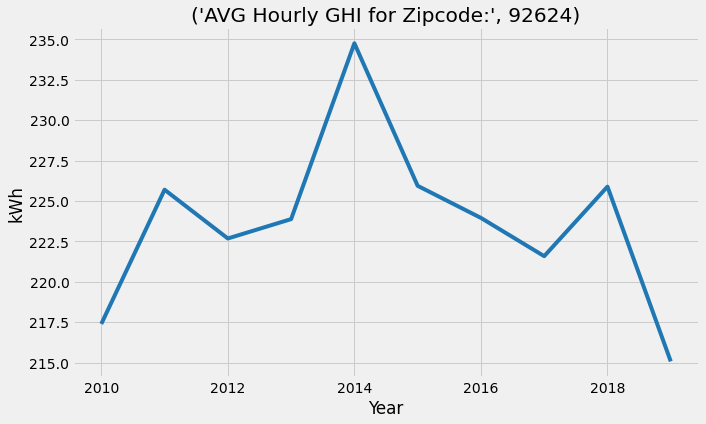

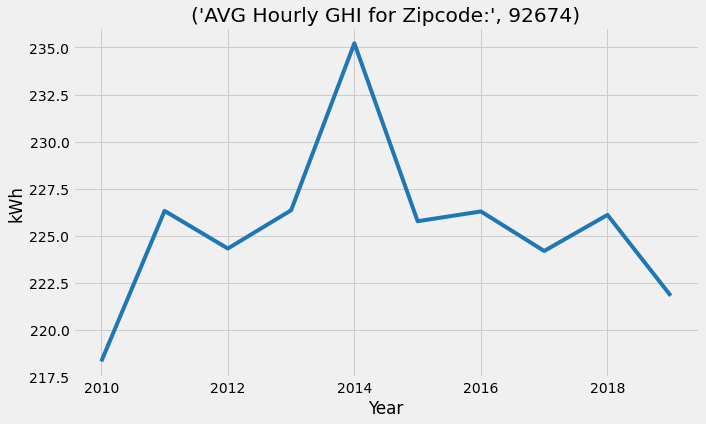

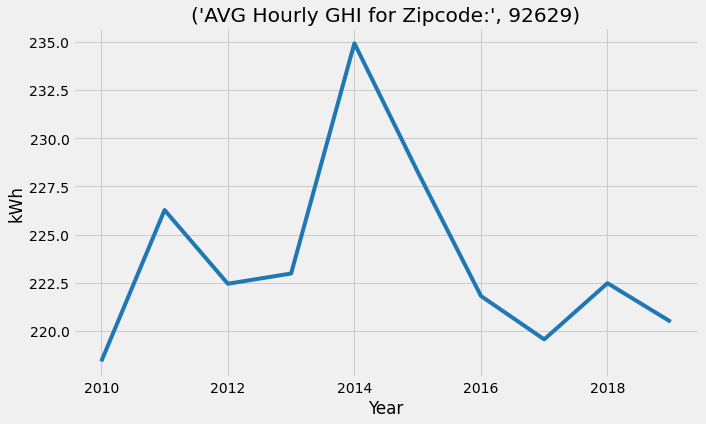

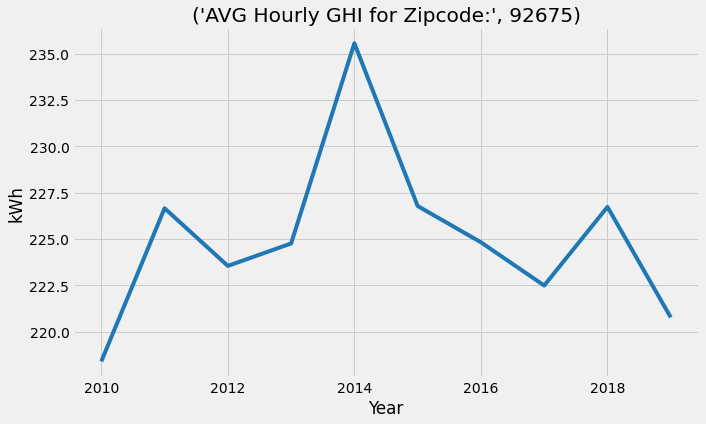

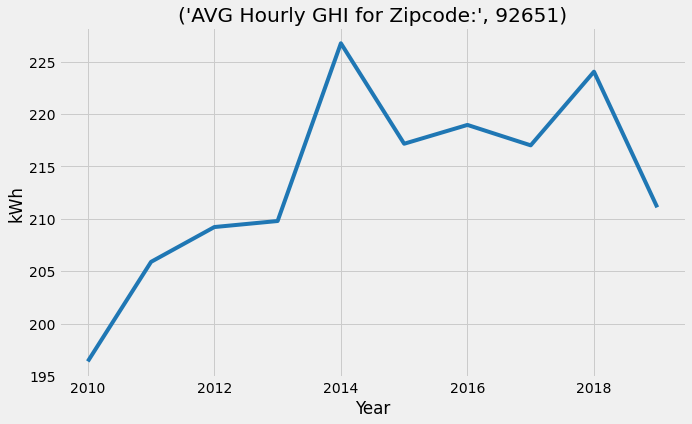

...

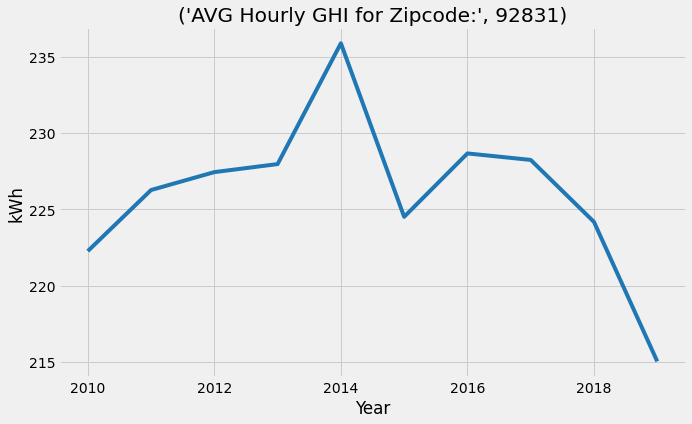

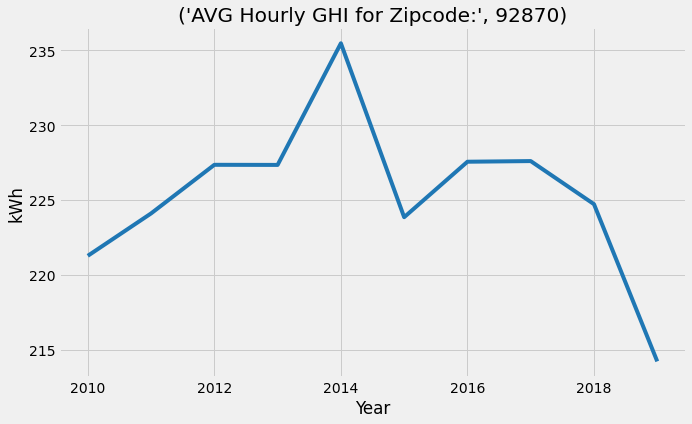

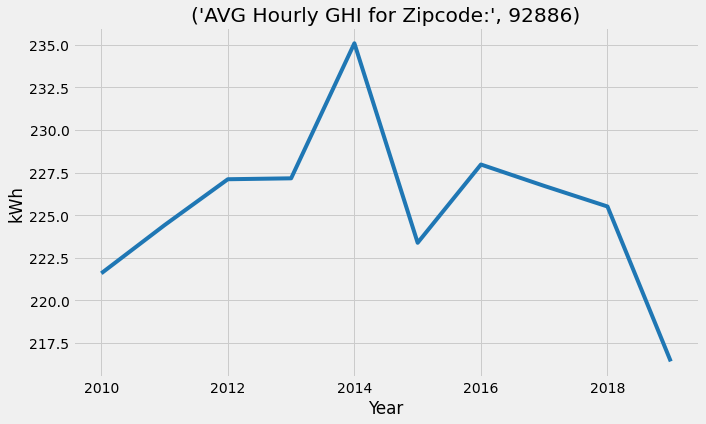

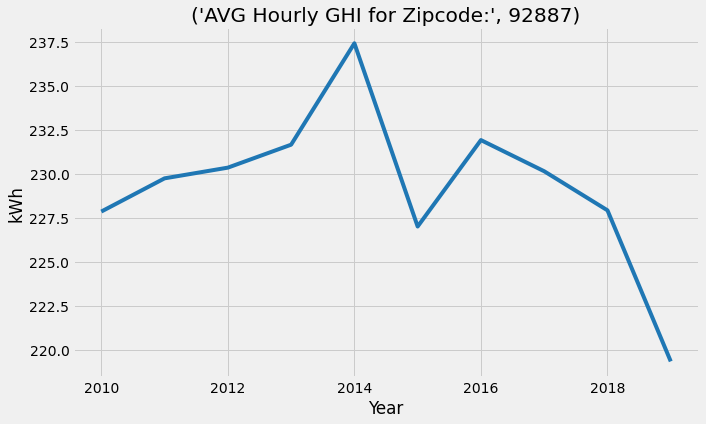

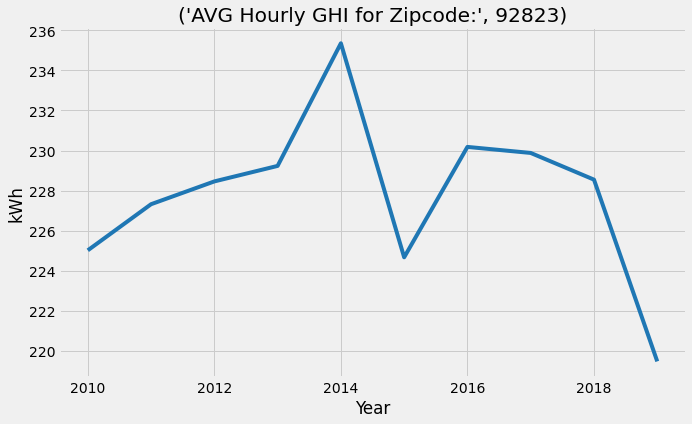

In [44]:
plt.style.use('fivethirtyeight')
for i in zip:
  dat3 = dat2.loc[(dat2["Zipcode"] == i)]
  plt.figure(figsize = (10,6))
  plt.plot(dat3.Year, dat3.hourly_avg, color='tab:blue')
  plt.gca().set(title=('AVG Hourly GHI for Zipcode:', i), xlabel='Year', ylabel="kWh")
  plt.show()
  i = i + 1

In [149]:
slope, intercept, r_value, p_value, std_err = stats.linregress(dat3['Year'], dat3['hourly_avg'])
print('Slope:', slope)
print('Intercept:',intercept)
print('R-square:', r_value)
print('p-value:',p_value)
print('Std_error:', std_err)

Slope: -0.13125397312413384
Intercept: 489.70920972680926
R-square: -0.06660385978602092
p-value: 0.08041039278124935
Std_error: 0.07496411485871865


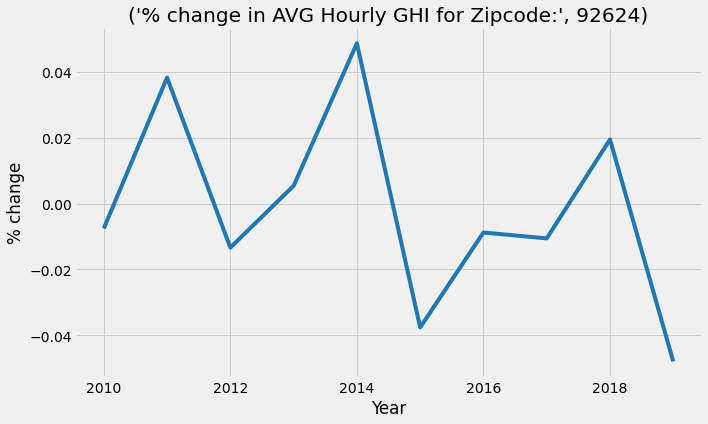

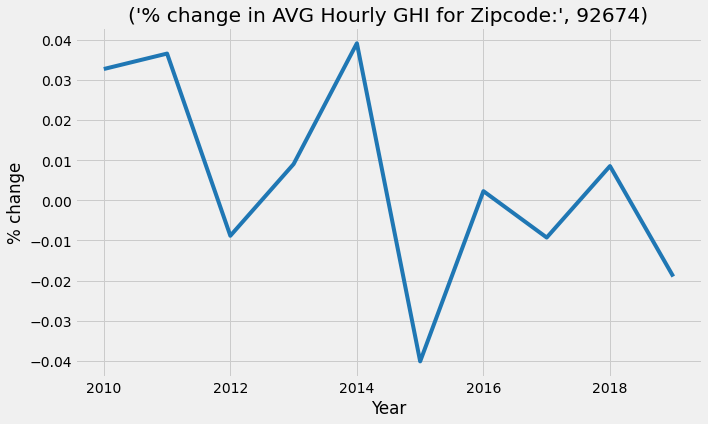

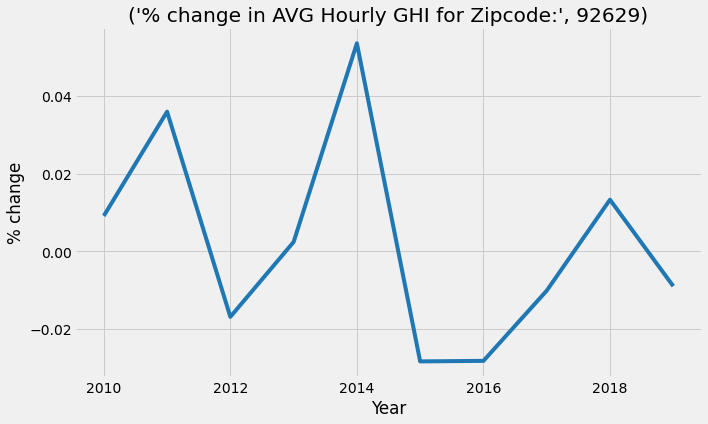

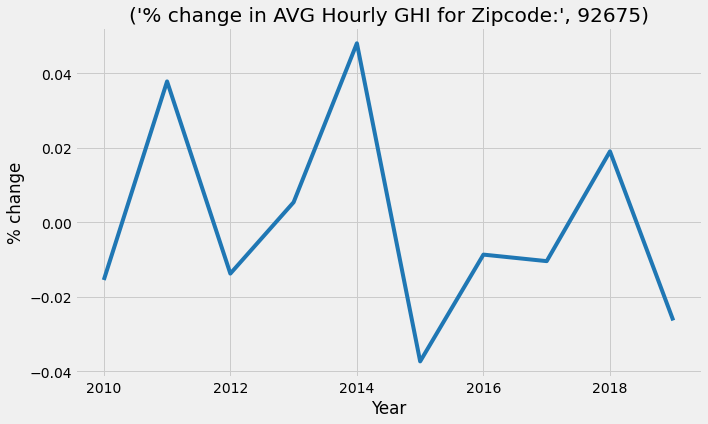

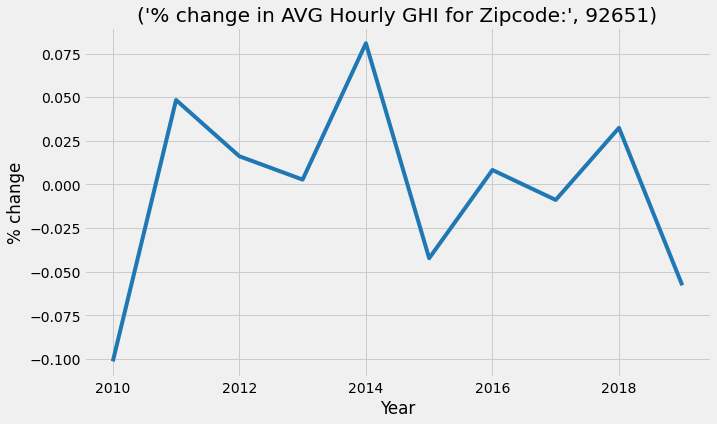

...

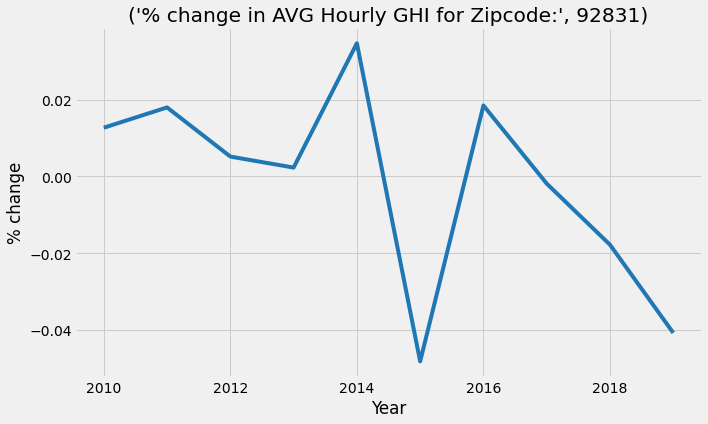

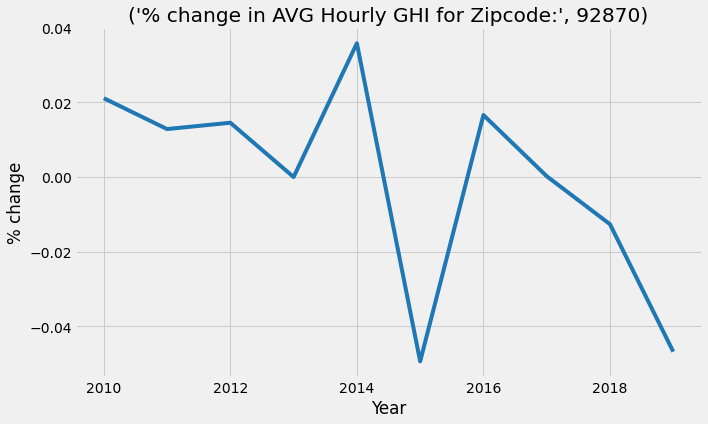

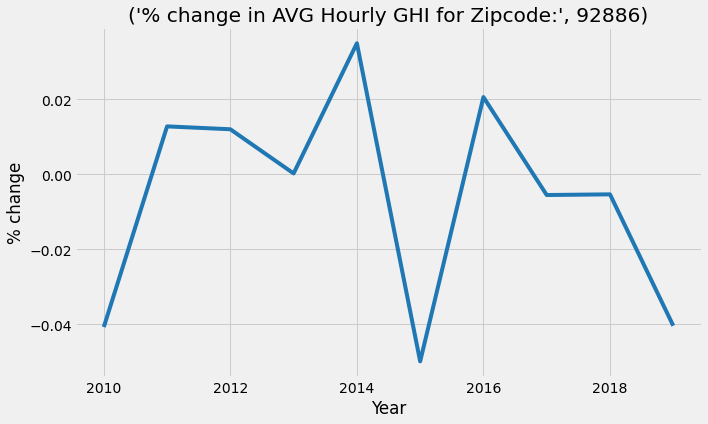

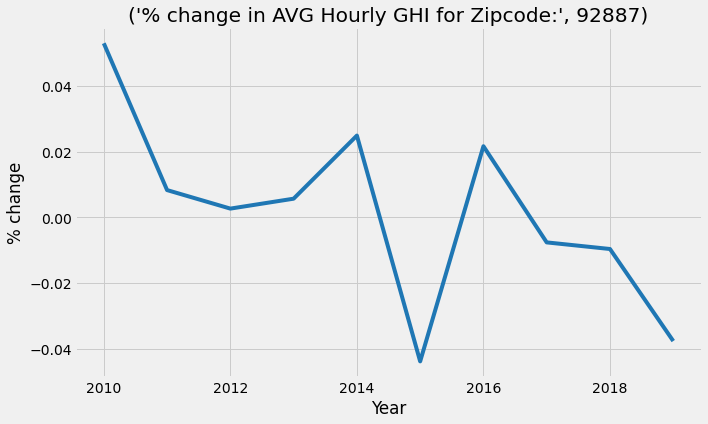

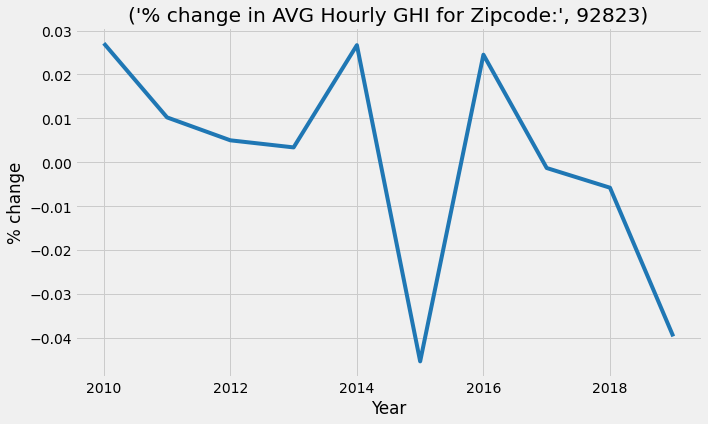

In [33]:
plt.style.use('fivethirtyeight')
for i in zip:
  dat4 = dat2.loc[(dat2["Zipcode"] == i)]
  plt.figure(figsize = (10,6))
  plt.plot(dat4.Year, dat4.Percentage_diff, color='tab:blue')
  plt.gca().set(title=('% change in AVG Hourly GHI for Zipcode:', i), xlabel='Year', ylabel="% change")
  plt.show()
  i = i + 1


In [148]:
slope, intercept, r_value, p_value, std_err = stats.linregress(dat4['Year'], dat4['Percentage_diff'])
print('Slope:', slope)
print('Intercept:',intercept)
print('R-square:', r_value)
print('p-value:',p_value)
print('Std_error:', std_err)

Slope: -0.004563691963294224
Intercept: 9.194035067822396
R-square: -0.5420550303404117
p-value: 0.10553064331610107
Std_error: 0.0025014079919490027


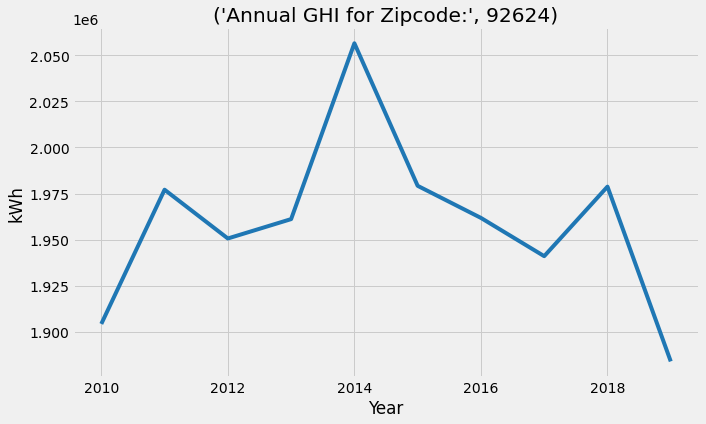

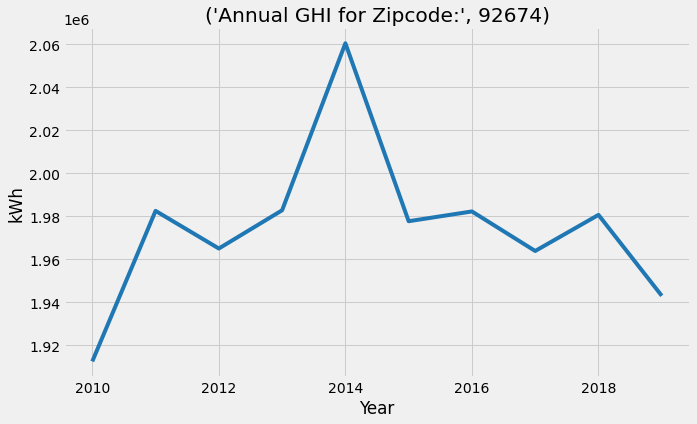

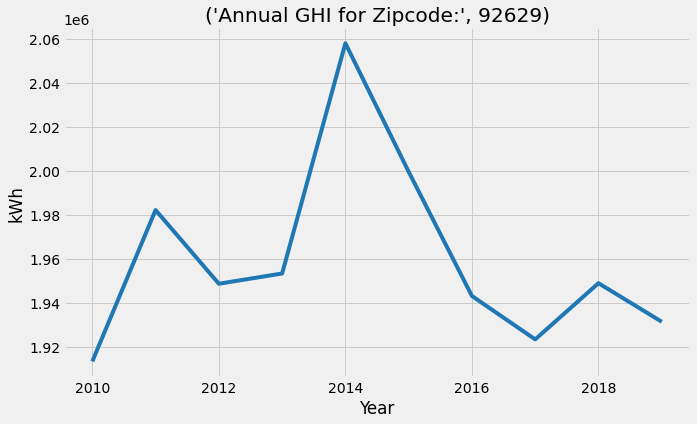

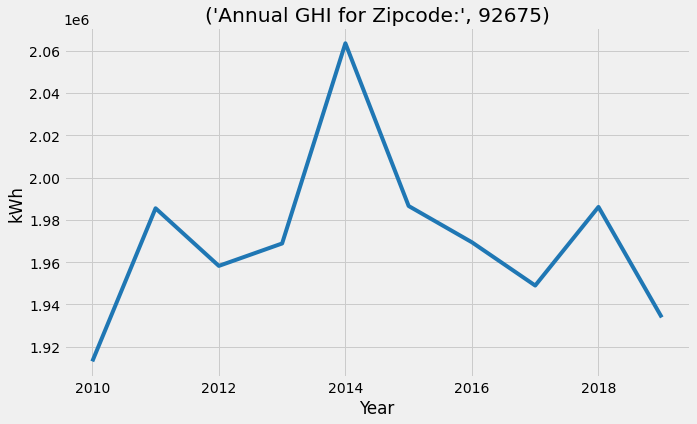

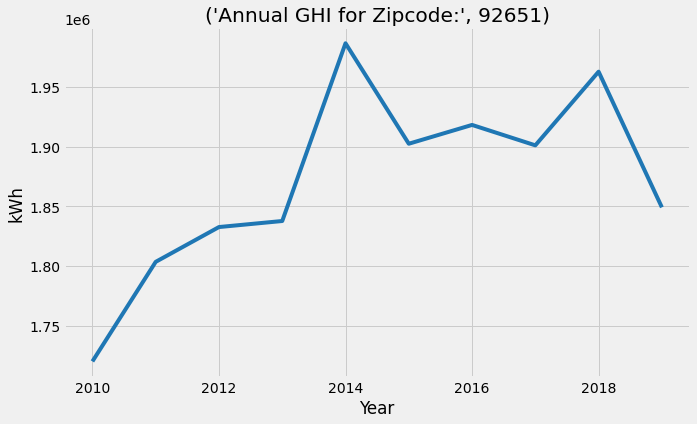

...

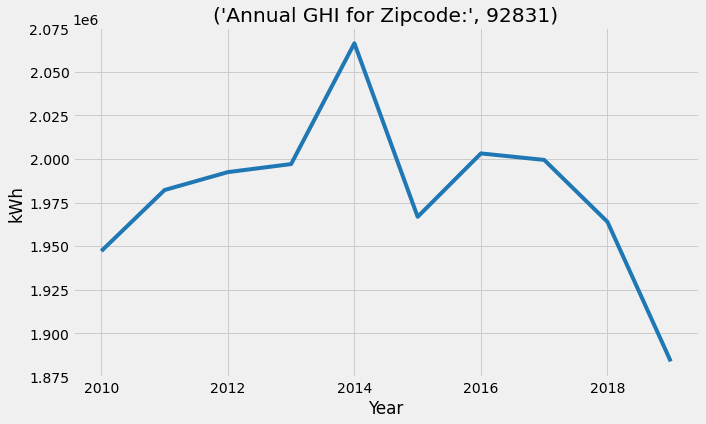

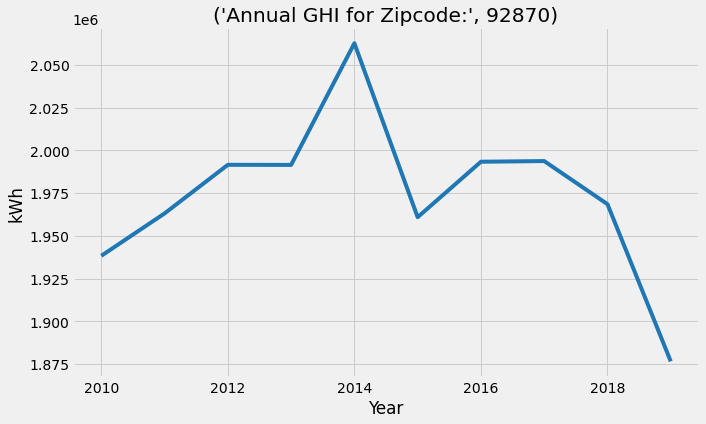

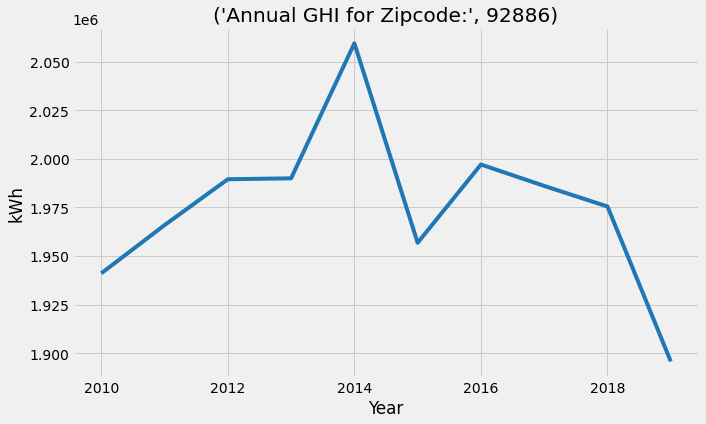

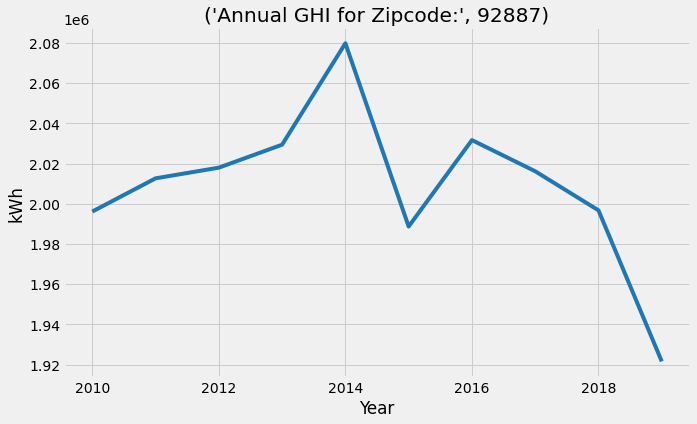

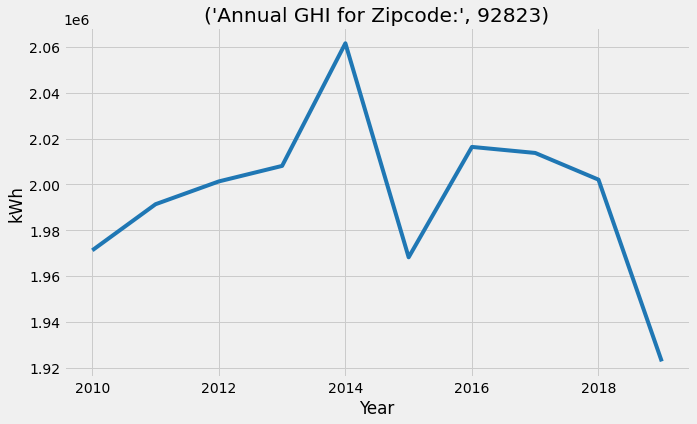

In [45]:
plt.style.use('fivethirtyeight')
for i in zip:
  dat5 = dat2.loc[(dat2["Zipcode"] == i)]
  plt.figure(figsize = (10,6))
  plt.plot(dat5.Year, dat5.GHI, color='tab:blue')
  plt.gca().set(title=('Annual GHI for Zipcode:', i), xlabel='Year', ylabel="kWh")
  plt.show()
  i = i + 1

In [147]:
slope, intercept, r_value, p_value, std_err = stats.linregress(dat5['Year'], dat5['GHI'])
print('Slope:', slope)
print('Intercept:',intercept)
print('R-square:', r_value)
print('p-value:',p_value)
print('Std_error:', std_err)

Slope: -2229.890909090909
Intercept: 6487779.636363637
R-square: -0.18463152368463628
p-value: 0.609607064191031
Std_error: 4196.636666213715


In [37]:
#select columns required to calculate monthly average GHI
dat6 = dat[["Zipcode", "Year", "Month", "GHI"]]
Stat2 = dat6.groupby(['Zipcode','Year', "Month"]).mean()
dat7 = pd.DataFrame(Stat2)
dat7.reset_index(inplace=True)
dat7.head()

,Zipcode,Year,Month,GHI
0,90620,2010,1,115.482527
1,90620,2010,2,158.194940
2,90620,2010,3,228.955645
3,90620,2010,4,268.988889
4,90620,2010,5,310.952957


In [38]:
dat7.to_csv('monthly-mean.csv')

In [39]:
dat8 = pd.read_csv('/content/monthly-mean.csv', parse_dates={ 'Date': ['Year', 'Month'] })
dat8 = dat8[["Date", "Zipcode","GHI"]]
dat8.head()

,Date,Zipcode,GHI
0,2010-01-01,90620,115.482527
1,2010-02-01,90620,158.194940
2,2010-03-01,90620,228.955645
3,2010-04-01,90620,268.988889
4,2010-05-01,90620,310.952957


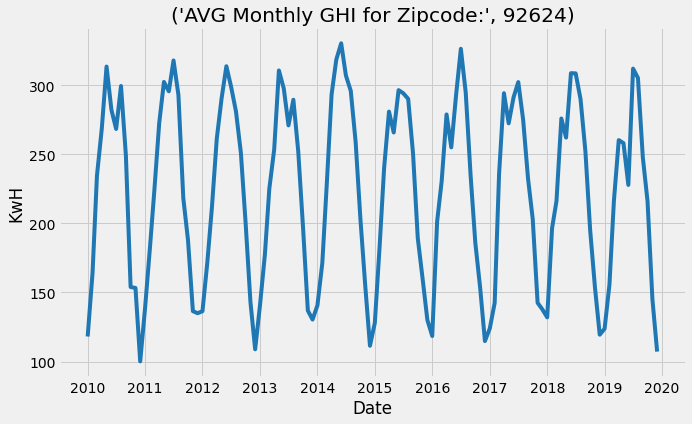

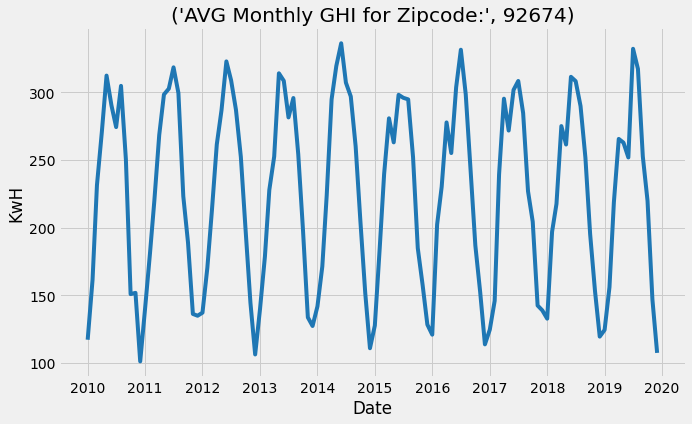

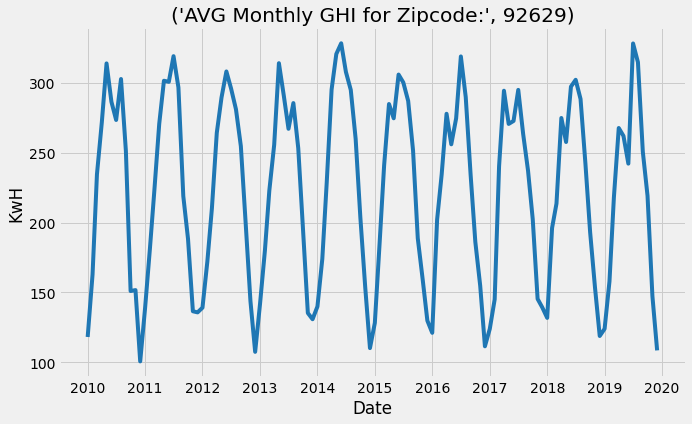

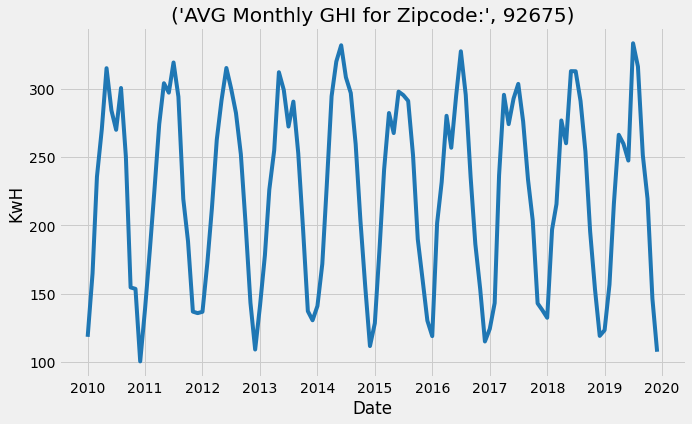

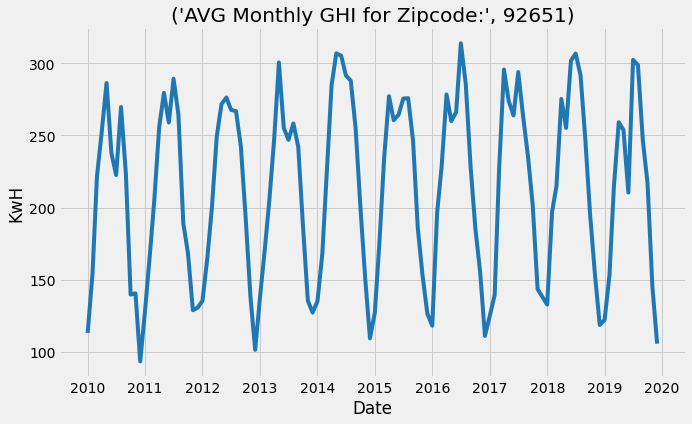

...

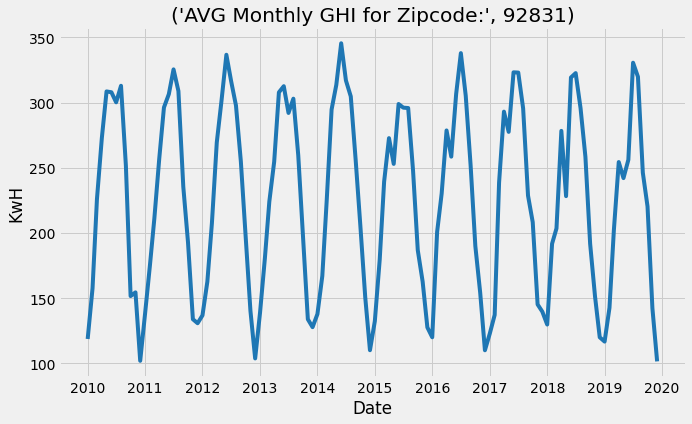

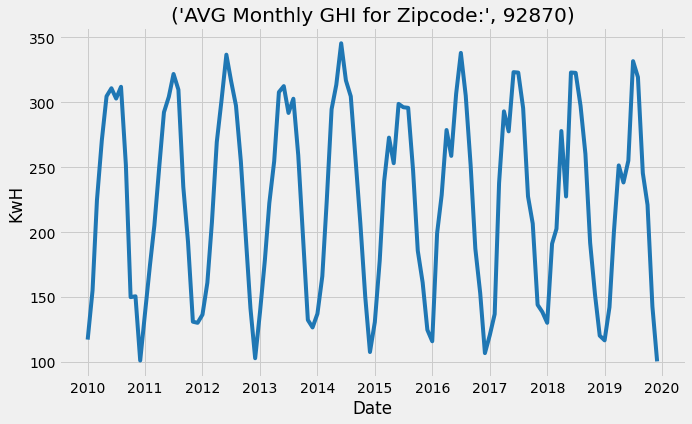

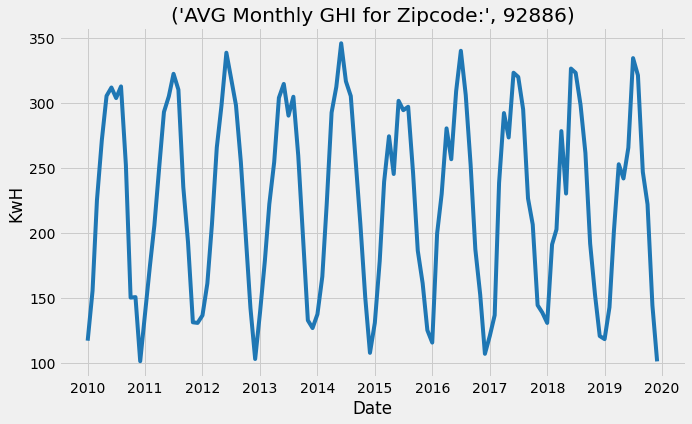

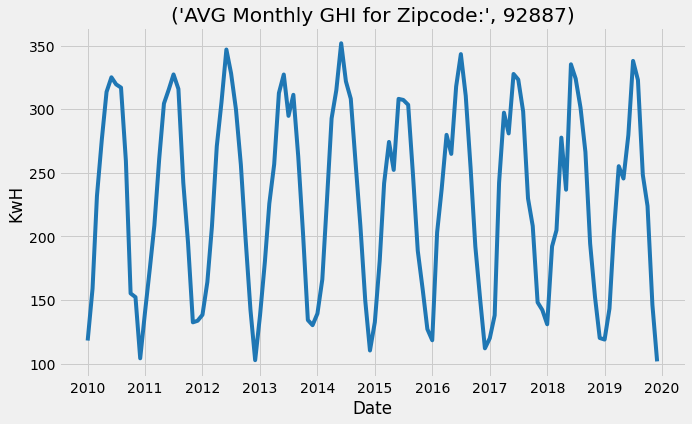

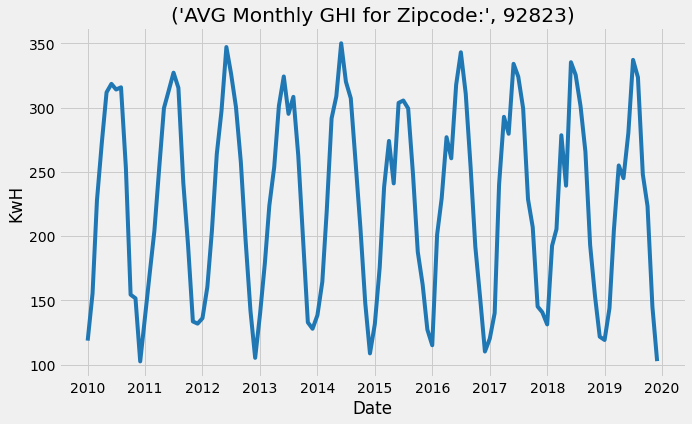

In [40]:
plt.style.use('fivethirtyeight')
for i in zip:
  dat9 = dat8.loc[(dat8["Zipcode"] == i)]
  plt.figure(figsize = (10,6))
  plt.plot(dat9.Date, dat9.GHI, color='tab:blue')
  plt.gca().set(title=('AVG Monthly GHI for Zipcode:', i), xlabel='Date', ylabel="kWh")
  plt.show()
  i = i + 1

In [146]:
#dat9['date_ordinal'] = pd.to_datetime(dat9['Date']).map(dt.datetime.toordinal)
slope, intercept, r_value, p_value, std_err = stats.linregress(dat9['date_ordinal'], dat9['GHI'])
print('Slope:', slope)
print('Intercept:',intercept)
print('R-square:', r_value)
print('p-value:',p_value)
print('Std_error:', std_err)

Slope: -0.0012693659025681486
Intercept: 1161.2785827375549
R-square: -0.018141631338420807
p-value: 0.8440876016925338
Std_error: 0.006440180036094174


In [133]:
# Select the subset data
temp_dat = df[["Date","Zipcode", "GHI"]]
mask = (temp_dat["Zipcode"] == 92624) 
temp_dat = temp_dat.loc[mask]

# Reset the index 
temp_dat.set_index("Date", inplace=True)

# Inspect first 5 rows and last 5 rows of the data
from IPython.display import display
display(temp_dat.head(5))
display(temp_dat.tail(5))

,Zipcode,GHI
Date,,
2010-01-01,92624,0
2010-01-01,92624,0
2010-01-01,92624,0
2010-01-01,92624,0
2010-01-01,92624,0


,Zipcode,GHI
Date,,
2019-12-31,92624,0
2019-12-31,92624,0
2019-12-31,92624,0
2019-12-31,92624,0
2019-12-31,92624,0


In [134]:
print('Summary for zipcode: 92624')
temp_dat.describe()

Summary for zipcode: 92624


,Zipcode,GHI
count,87600.0,87600.000000
mean,92624.0,223.682180
std,0.0,310.301547
min,92624.0,0.000000
25%,92624.0,0.000000
50%,92624.0,2.000000
75%,92624.0,424.000000
max,92624.0,1065.000000


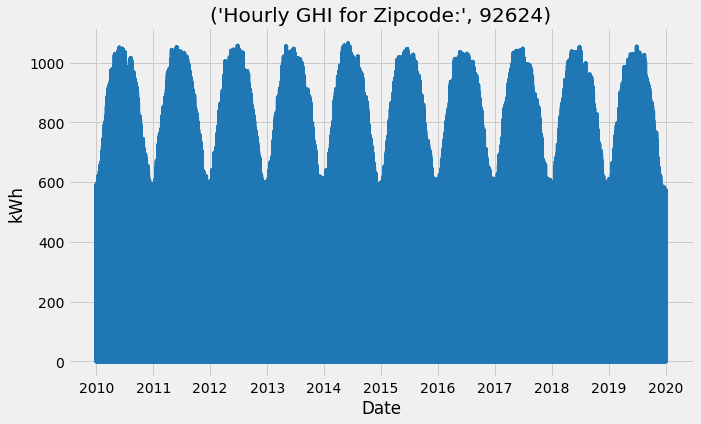

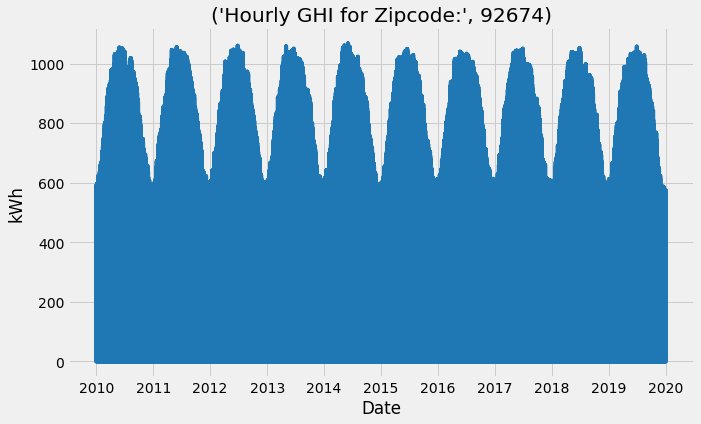

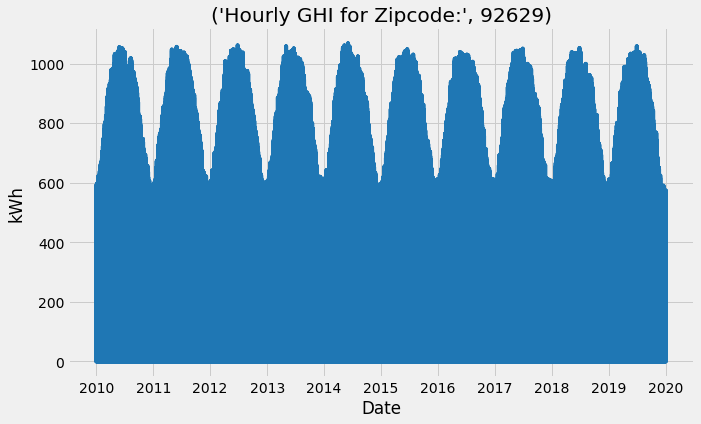

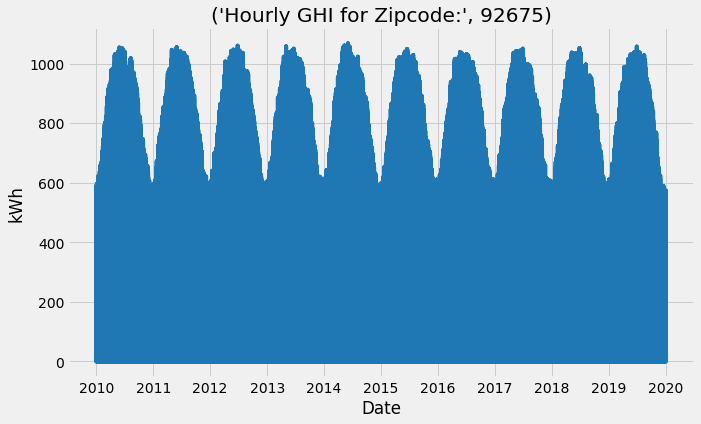

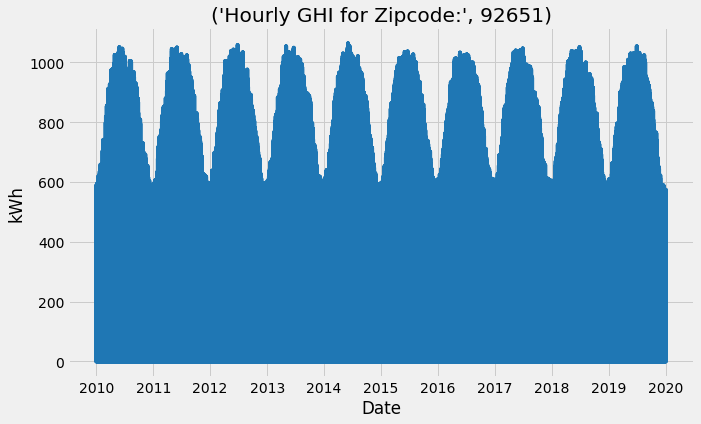

...

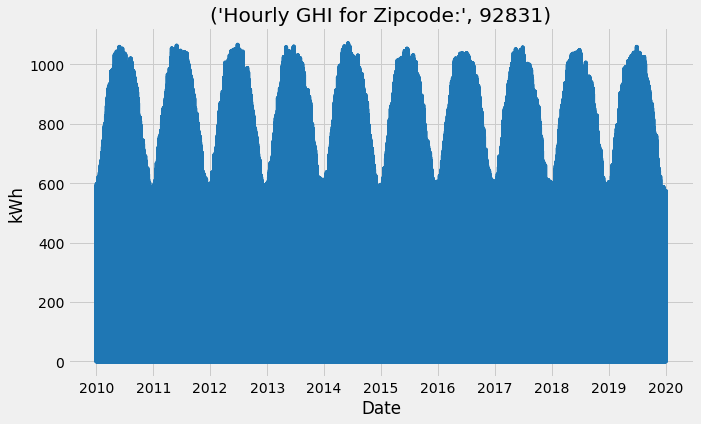

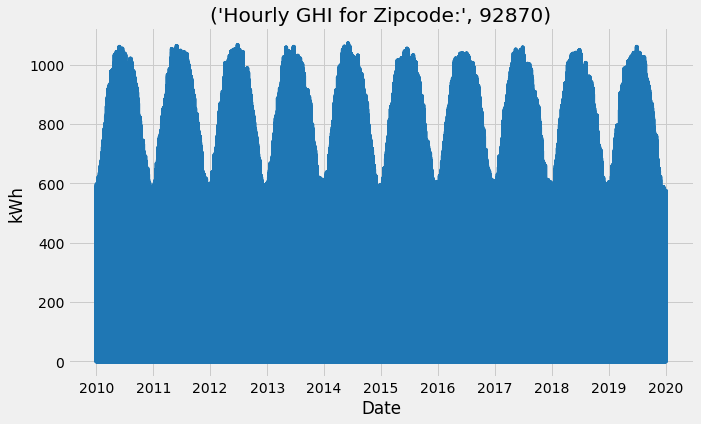

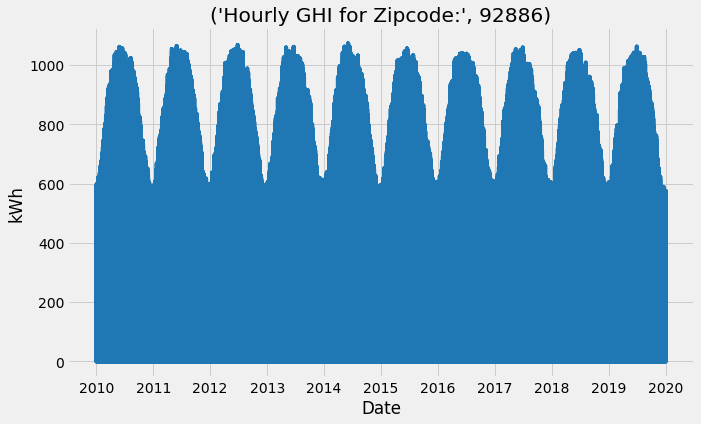

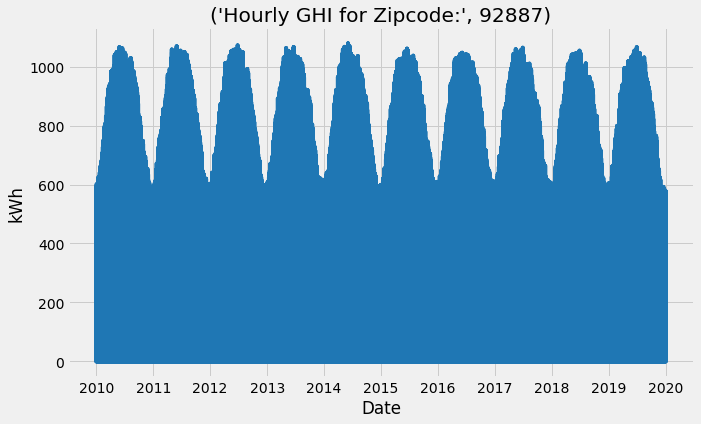

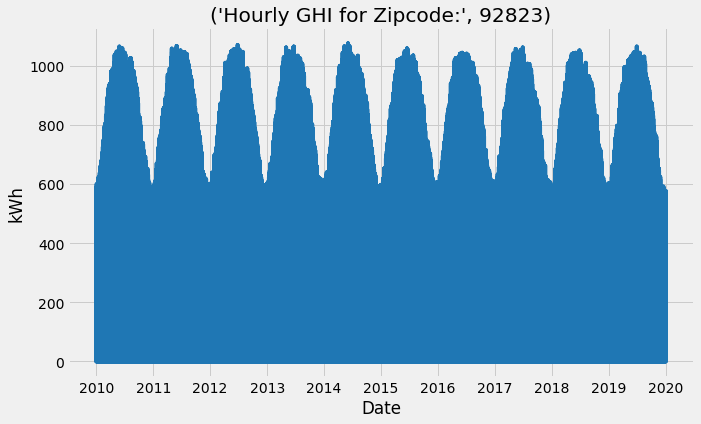

In [43]:
plt.style.use('fivethirtyeight')
for i in zip:
  temp = df.loc[(df["Zipcode"] == i)]
  plt.figure(figsize = (10,6))
  plt.plot(temp.Date, temp.GHI, color='tab:blue')
  plt.gca().set(title=('Hourly GHI for Zipcode:', i), xlabel='Date', ylabel="kWh")
  plt.show()
  i = i + 1

In [13]:
temp['date_ordinal'] = pd.to_datetime(temp['Date']).map(dt.datetime.toordinal)
slope, intercept, r_value, p_value, std_err = stats.linregress(temp['date_ordinal'], temp['GHI'])
print('Slope:', slope)
print('Intercept:',intercept)
print('R-square:', r_value)
print('p-value:',p_value)
print('Std_error:', std_err)

Slope: -0.0013138405803907569
Intercept: 1194.2749512440957
R-square: -0.004396634083956001
p-value: 0.193165170973288
Std_error: 0.0010096504808804673


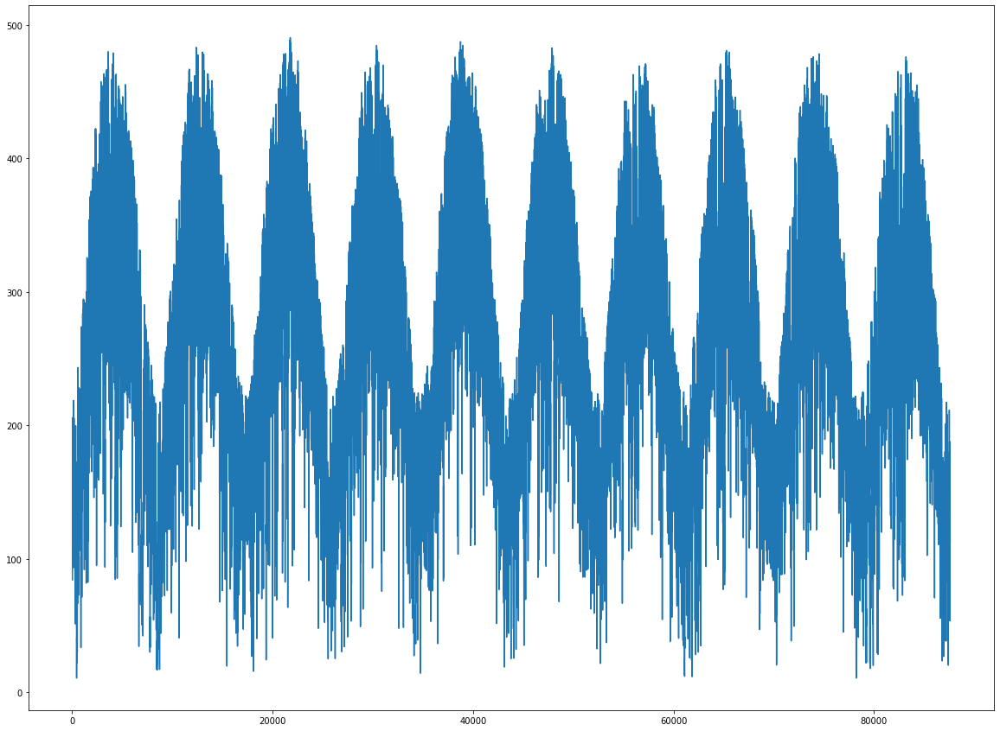

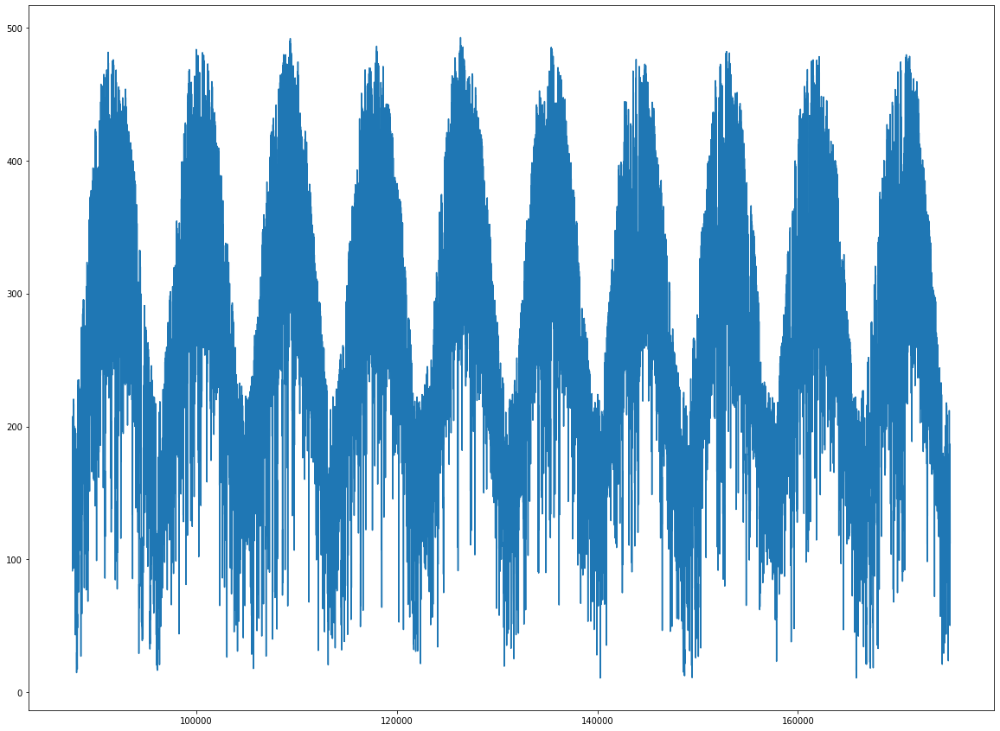

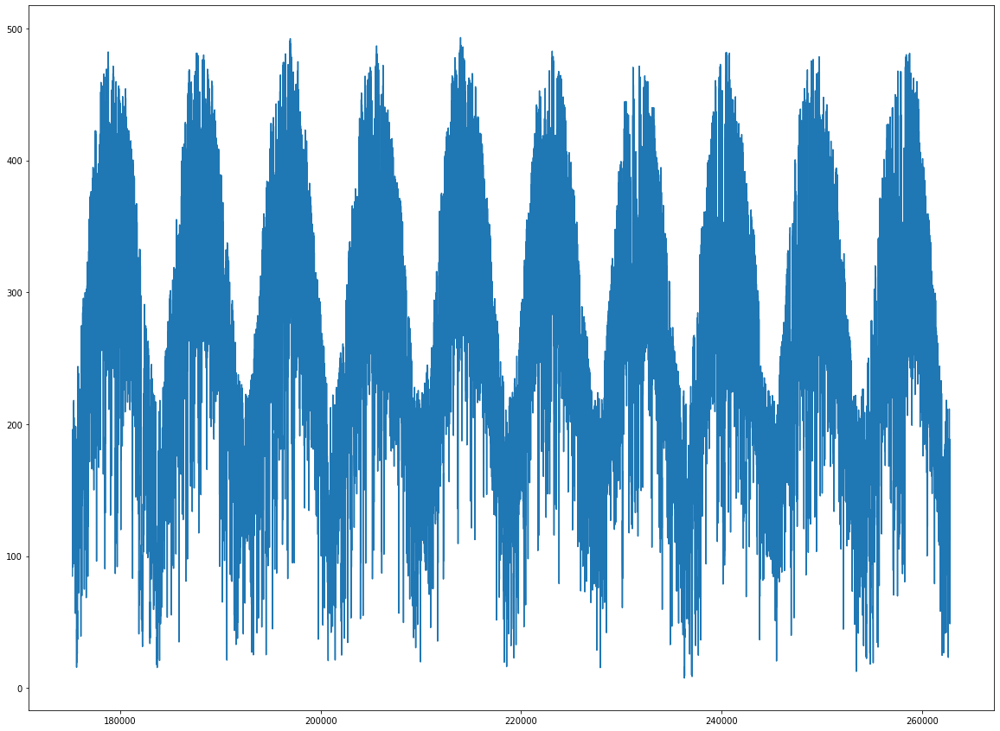

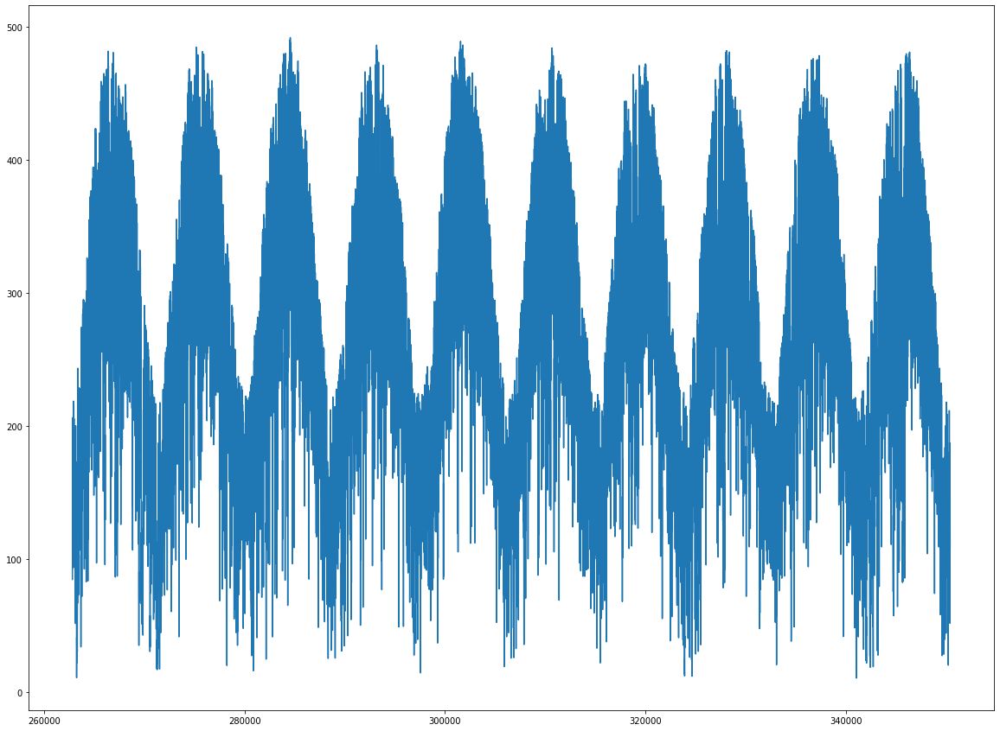

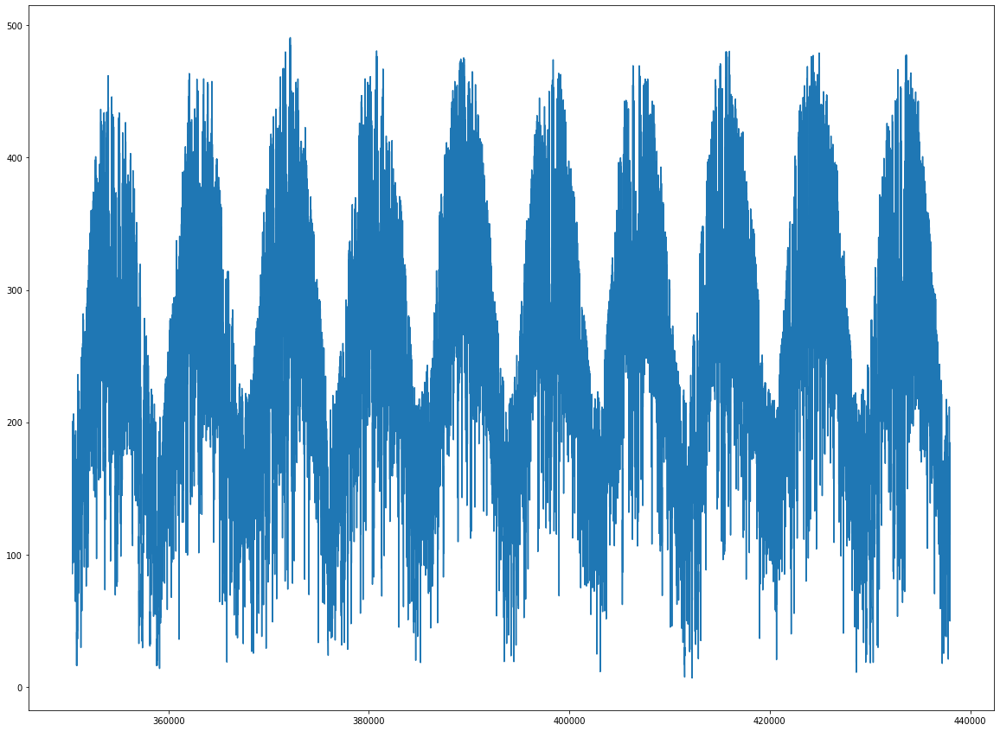

...

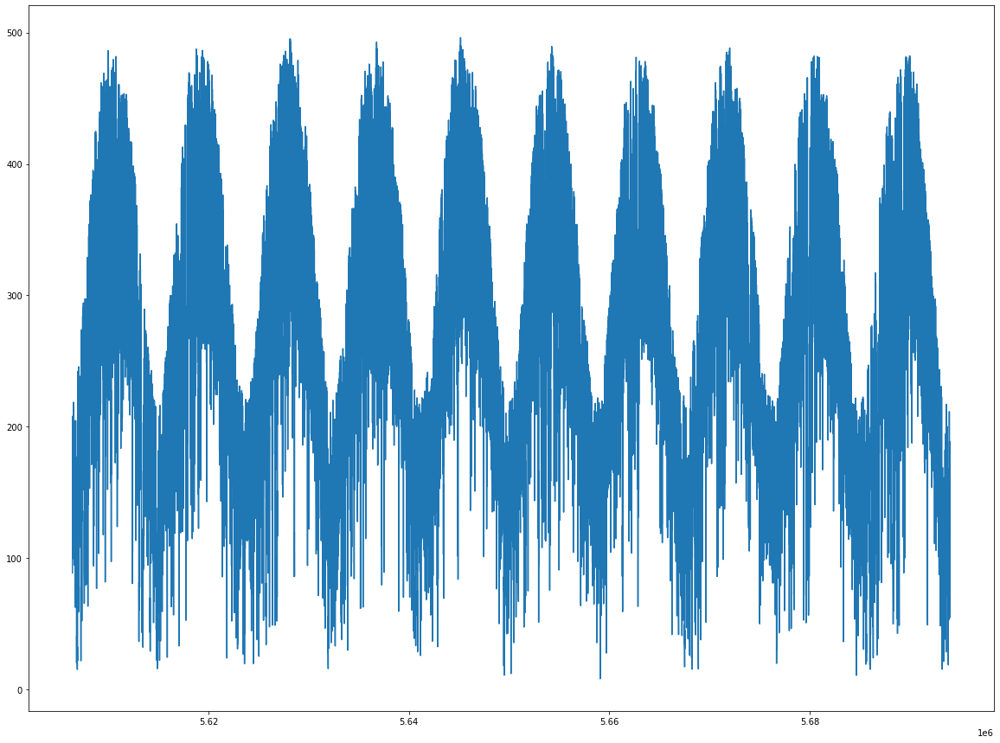

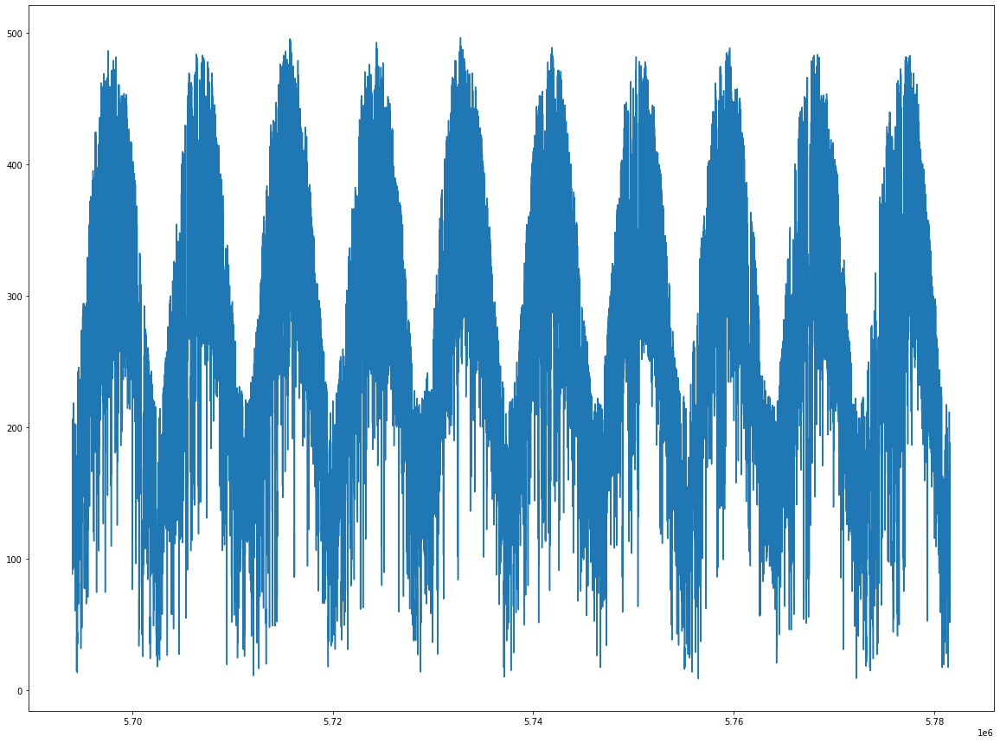

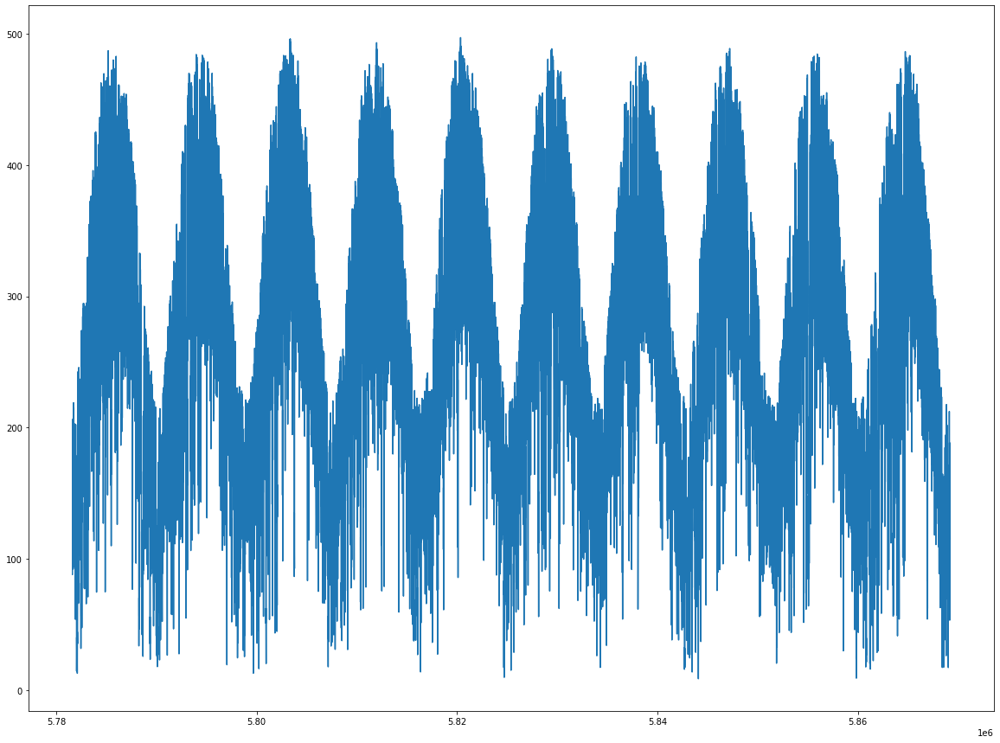

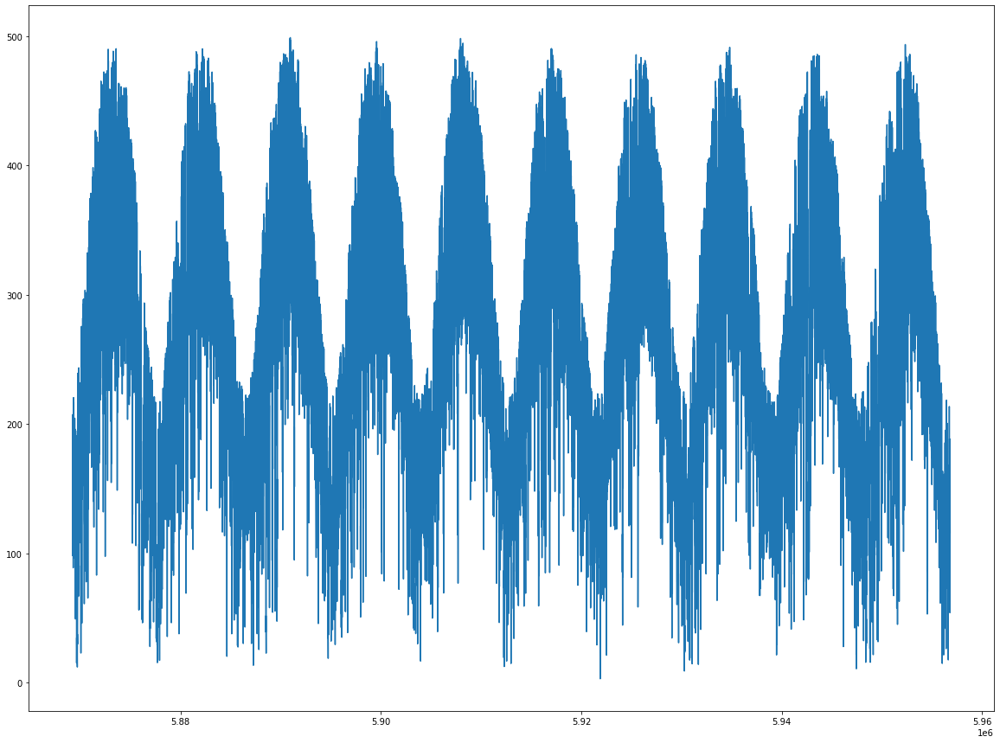

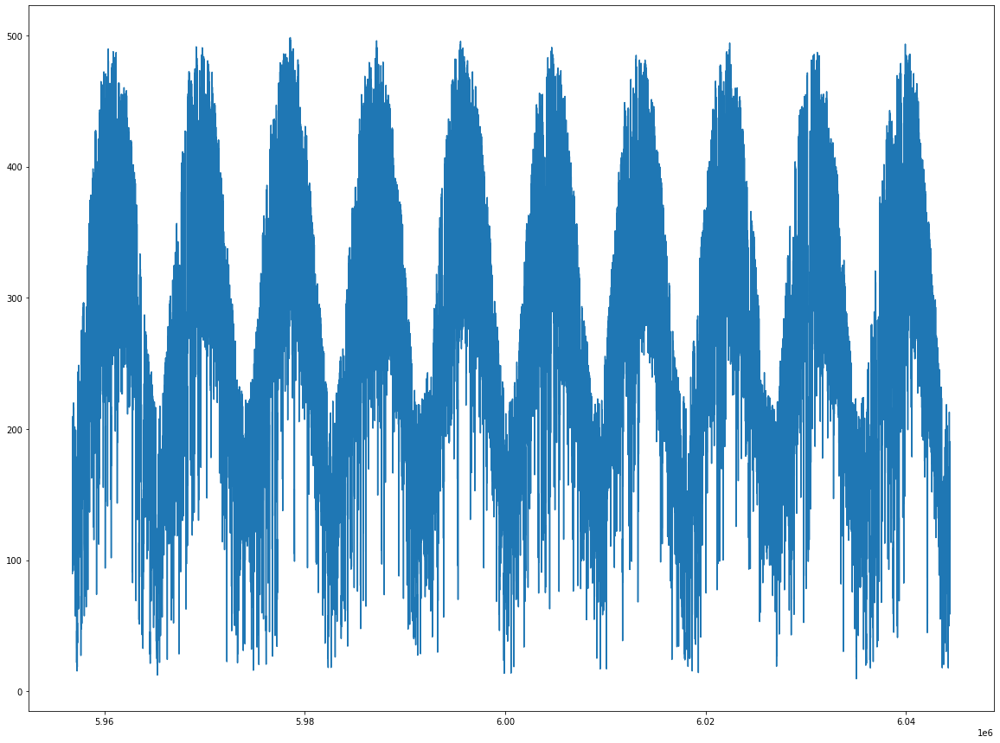

In [136]:
# Apply the Moving Average function by a subset of size 30 days.
#plt.figure(figsize=(16,10), dpi=100)
for i in zip:
  temp = df.loc[(df["Zipcode"] == i)]
  temp_df_mean = temp.GHI.rolling(window=30).mean()
  temp_df_mean.plot(figsize=(20,15))
  plt.show()
  i = i + 1

/usr/local/lib/python3.7/dist-packages/statsmodels/tools/_testing.py:19: FutureWarning: pandas.util.testing is deprecated. Use the functions in the public API at pandas.testing instead.
  import pandas.util.testing as tm


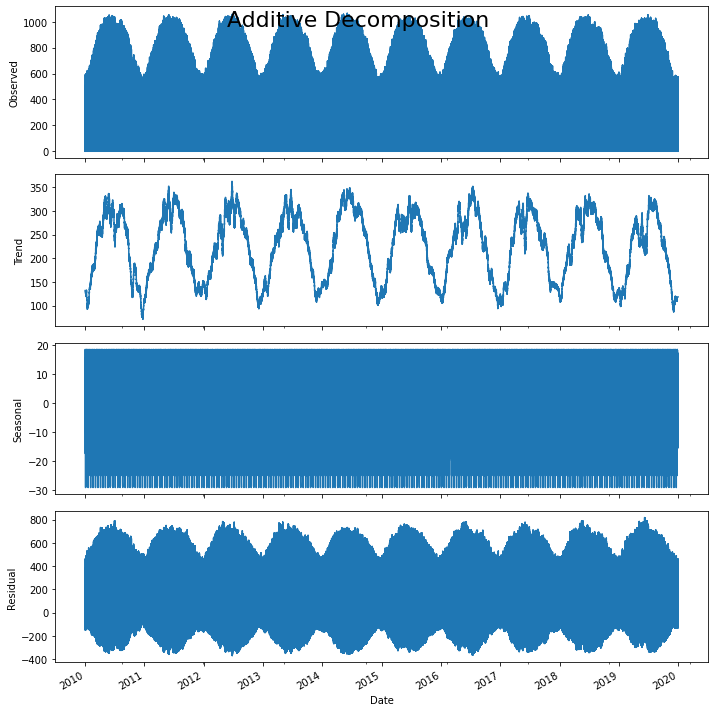

In [137]:
from statsmodels.tsa.seasonal import seasonal_decompose

# Additive Decomposition
result_add = seasonal_decompose(temp_dat.GHI, model='additive', extrapolate_trend='freq', freq=365)

# Plot
plt.rcParams.update({'figure.figsize': (10,10)})
result_add.plot().suptitle('Additive Decomposition', fontsize=22)
plt.show()